<a name='Introduction'></a>
# Crime in Montgomery County
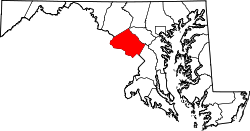

Out of the 24 counties in the state of Maryland, Montgomery County is the most populous. It boasts the 20th highest household income in the country, and interestingly, the highest percentage of residents over the age of 25 who hold post-graduate degrees (Montgomery County, Maryland). High household income and education indicate that Montgomery County could be a good place to live - but they aren't the only things to consider.

When evaluating a place to work/live/visit, safety is paramount, and one of the largest components of safety is crime. Montgomery County is a large geographical area, covering 507 square miles with a population of over 1 million residents, and therefore it is not sufficient to simply look at overall crime rate statistics to determine if it's a safe place to live. We asked ourselves the following questions:

* How has crime in Montgomery Changed over the past 7 years, in terms of rates, trends and patterns?
* What impact did COVID have on crime in Montgomery County, and why?
* What impact have different Montgomery County police departments had on crime rates? 
* What sub-regions of Montgomery County are safer to live in, and why?

In order to answer these questions, we embarked on a data analysis journey to determining whether Montgomery County is a "safe" place to live, hoping to find evidence that crime was trending downward, the police department was effective at containing and addressing crime, and if there are any demographic factors that contribute to different patterns within the county.

We produced 6 analyses to answer these questions - our project should be graded more heavily on data analysis.

## Table of Contents
* [Project Overview](#Introduction)
* [Data Acquisition](#Data)
* [Exploratory Data Analysis](#EDA)
* [Data Cleaning](#DC)
* Analyses
    * [Crime Rates over Time](#A1)
    * [Impact of COVID-19 on Crime in Montgomery County](#A2)
    * [Mapping Crime in Montgomery County](#A3)
    * [Heatmap Analysis](#A4)
    * [Police Agency Efficiency](#A5)
    * [Correlation Matrix](#A6)
* [Conclusion](#C)
* [References](#References)
* [Glossary](#Glossary)

First, we will need to install and import all required libraries.

In [1]:
# install ipympl for animated visualization
#! conda install -c conda-forge ipympl

In [2]:
# install wordcloud 
#! conda install -c conda-forge wordcloud

In [3]:
# install folium for animated map visualization
#! conda install -c conda-forge folium

In [4]:
# Import core packages
import pandas as pd
import numpy as np
import re
import datetime as dt
from matplotlib import pyplot as plt
import seaborn as sns
import requests
import matplotlib

# Import packages for animation
from matplotlib import animation
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, Javascript

# Import packages for map visualizations
import folium
from folium import plugins
from folium.plugins import MarkerCluster
from folium.plugins import HeatMapWithTime

#Importing Mandatory Libraries
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Import packages for panel visualization
import panel as pn
pn.extension('tabulator')
import hvplot.pandas
import holoviews as hv
from bokeh.models import HoverTool
from io import BytesIO
import base64

# Import wordcloud library
from wordcloud import WordCloud  

%matplotlib widget

In [5]:
# set some notebook parameters
pd.options.mode.chained_assignment = None 

## Data
<a name='Data'></a>
The Montgomery County government has a comprehensive collection of datasets that report on county demographics, businesses, public safety, and more. From that, we were able to find a dataset that had the potential to answer our questions in the form of a [csv file](https://data.montgomerycountymd.gov/Public-Safety/Crime/icn6-v9z3) that we can download from their website.

This dataset is updated daily with new crime reports, and contains data that spans from 2017 to the present. It contains 282,000 rows, and has 30 columns containing detailed information about each incident - including start time, number of victims, location, and type of crime. From this plethora of data we will be able to drill down to the most important variables and indicators that we will use to answer our questions.

We downloaded the final version that is used in our analysis on November 08, 2023.

In [6]:
# Load Montgomery dataset
montgomery_crime_df = pd.read_csv('Montgomery_Crime.csv', index_col = ['Incident ID'], dtype={'PRA': str})

## Exploratory Data Analysis
<a name='EDA'></a>
The first step of this process is to examine our dataset and understand its main characteristics, which will help us formulate some initial assumptions. This will help us identify any obvious errors, identify patterns, detect outliers, and lay the foundation for the data cleaning tasks that will need to be done.

In [7]:
# Inspect first 5 observations
montgomery_crime_df.head(5)

,Offence Code,CR Number,Dispatch Date / Time,Start_Date_Time,End_Date_Time,NIBRS Code,Victims,Crime Name1,Crime Name2,Crime Name3,...,Location,Council Districts,Councils,Communities,Zip Codes,Municipalities,Council Districts_from_i23j_3mj8,Service Regions,Montgomery County Boundary,Council Districts 7
Incident ID,,,,,,,,,,,,,,,,,,,,,
201452140,1205,230065034,11/08/2023 03:20:12 AM,11/08/2023 03:20:00 AM,NaN,120,1,Crime Against Property,Robbery,ROBBERY - STREET-OTHER WEAPON,...,"(38.9918, -77.0241)",5.0,5.0,7.0,3065.0,1.0,5.0,1.0,1.0,7.0
201452138,2203,230065033,11/08/2023 02:43:30 AM,11/08/2023 02:30:00 AM,11/08/2023 02:42:00 AM,220,1,Crime Against Property,Burglary/Breaking and Entering,BURGLARY - FORCED ENTRY-NONRESIDENTIAL,...,"(39.055, -77.1183)",3.0,3.0,19.0,60.0,1.0,3.0,3.0,1.0,7.0
201452136,1305,230065028,11/08/2023 01:08:41 AM,11/08/2023 12:08:00 AM,11/08/2023 01:50:00 AM,13A,1,Crime Against Person,Aggravated Assault,ASSAULT - AGGRAVATED - NON-FAMILY-OTHER WEAPON,...,"(39.0777, -77.14)",3.0,3.0,25.0,60.0,12.0,3.0,3.0,1.0,4.0
201452119,2601,230065015,11/07/2023 09:15:52 PM,11/07/2023 09:15:00 PM,NaN,26A,1,Crime Against Property,False Pretenses/Swindle/Confidence Game,FRAUD - CONFIDENCE GAME,...,"(39.0834, -77.0652)",4.0,4.0,59.0,6.0,1.0,4.0,4.0,1.0,2.0
201452132,1304,230065019,11/07/2023 09:06:46 PM,11/07/2023 09:06:00 PM,11/08/2023 12:00:00 AM,13A,5,Crime Against Person,Aggravated Assault,ASSAULT - AGGRAVATED - NON-FAMILY-GUN,...,"(39.1418, -77.2244)",3.0,3.0,36.0,33.0,21.0,3.0,5.0,1.0,4.0


In [8]:
# Calculate descriptive statistics about numerical variables in dataset
montgomery_crime_df.describe()

,Offence Code,CR Number,Victims,Zip Code,Address Number,Latitude,Longitude,Council Districts,Councils,Communities,Zip Codes,Municipalities,Council Districts_from_i23j_3mj8,Service Regions,Montgomery County Boundary,Council Districts 7
count,279992.000000,2.799920e+05,279992.000000,277598.000000,2.533180e+05,279992.000000,279992.000000,276220.000000,276220.000000,273817.000000,277334.000000,275385.000000,276220.000000,274351.000000,274100.0,276237.000000
mean,2802.817538,1.785562e+08,1.028054,20877.247509,8.530961e+03,38.709476,-76.380807,3.246278,3.246278,27.601161,421.351381,4.186887,3.246278,3.437713,1.0,4.069082
std,1193.342610,6.111787e+07,0.209805,163.822120,1.799520e+04,3.790282,7.478188,1.387858,1.387858,16.085272,995.212405,6.534121,1.387858,1.413078,0.0,2.018775
min,901.000000,1.004668e+07,1.000000,6.000000,0.000000e+00,0.000000,-77.516700,1.000000,1.000000,1.000000,6.000000,1.000000,1.000000,1.000000,1.0,1.000000
25%,2303.000000,1.800087e+08,1.000000,20854.000000,1.700000e+03,39.021810,-77.198300,2.000000,2.000000,16.000000,21.000000,1.000000,2.000000,2.000000,1.0,2.000000
50%,2399.000000,1.900553e+08,1.000000,20878.000000,8.200000e+03,39.072190,-77.098400,3.000000,3.000000,25.000000,39.000000,1.000000,3.000000,4.000000,1.0,4.000000
75%,2999.000000,2.100518e+08,1.000000,20904.000000,1.240000e+04,39.142190,-77.029700,5.000000,5.000000,39.000000,71.000000,1.000000,5.000000,5.000000,1.0,6.000000
max,9103.000000,2.301015e+08,22.000000,29878.000000,2.090600e+06,39.342600,0.000000,5.000000,5.000000,62.000000,3065.000000,24.000000,5.000000,5.000000,1.0,7.000000


In [9]:
# Display shape of dataset
df_shape = montgomery_crime_df.shape
df_shape

(279992, 38)

In [10]:
# Identify column types
df_column_types = montgomery_crime_df.dtypes
# df_column_types

In [11]:
# Identify columns with missing values
missing_columns = montgomery_crime_df.columns[montgomery_crime_df.isnull().any()]
print("Columns with missing values:")
print(montgomery_crime_df[missing_columns].isnull().sum())

Columns with missing values:
Dispatch Date / Time                 40628
End_Date_Time                       139934
Police District Name                   476
Block Address                        26773
City                                    13
State                                 5226
Zip Code                              2394
PRA                                      6
Address Number                       26674
Street Prefix                       267418
Street Name                            477
Street Suffix                       275349
Street Type                            785
Council Districts                     3772
Councils                              3772
Communities                           6175
Zip Codes                             2658
Municipalities                        4607
Council Districts_from_i23j_3mj8      3772
Service Regions                       5641
Montgomery County Boundary            5892
Council Districts 7                   3755
dtype: int64


We want to analyze the different types of crimes that are committed, and potentially do further categorization, so we first need to determine the existing categorization provided by this dataset.

In [12]:
# Display value counts for crime types to gather initial information about segments
montgomery_crime_df['Crime Name1'].value_counts()

Crime Name1
Crime Against Property    175277
Crime Against Society      67030
Crime Against Person       37685
Name: count, dtype: int64

In [13]:
# Display value counts for sub-category of crime type
crime_counts = montgomery_crime_df.groupby(['Crime Name1', 'Crime Name2']).size()
crime_counts

Crime Name1             Crime Name2                                
Crime Against Person    Aggravated Assault                              5428
                        Forcible Fondling                               2158
                        Forcible Rape                                   1709
                        Forcible Sodomy                                  730
                        Human Trafficking, Commercial Sex Acts            66
                        Human Trafficking, Involuntary Servitude           2
                        Incest                                             7
                        Intimidation                                     495
                        Justifiable Homicide                              14
                        Kidnapping/Abduction                              96
                        Murder and Nonnegligent Manslaughter             153
                        Negligent Manslaughter                             2
        

In [14]:
# Display value counts for final sub-category of crime type
crime_sub_category = montgomery_crime_df.groupby(['Crime Name1', 'Crime Name2', 'Crime Name3']).size()
crime_sub_category

Crime Name1            Crime Name2            Crime Name3                               
Crime Against Person   Aggravated Assault     ASSAULT - AGGRAVATED - FAMILY-GUN              108
                                              ASSAULT - AGGRAVATED - FAMILY-OTHER WEAPON     853
                                              ASSAULT - AGGRAVATED - FAMILY-STRONG-ARM       763
                                              ASSAULT - AGGRAVATED - GUN                     666
                                              ASSAULT - AGGRAVATED - NON-FAMILY-GUN          284
                                                                                            ... 
Crime Against Society  Weapon Law Violations  WEAPON - INCENDIARY DEVICE - USING               4
                                              WEAPON - POSSESSION                           1275
                                              WEAPON - SELLING                                 3
                                      

## Data Cleaning
<a name='DC'></a>
We have several columns with thousands of observations that are null. There is also the potential that our data may be corrupted, improperly formatted, duplicated, or incomplete. In order to rectify these issues, we will need to clean this dataset prior to performing any analyses, as inaccurate data can lead to unreliable algorithms/results.

### Identify and Remove Duplicate Observations

Before we proceed with handling the null data, we should determine if there are any duplicates. We will do this by looking specifically at the Incident ID - duplicates may have resulted from errors in data entry, data extraction, or other data collection processes.

In [15]:
# Identify duplicate records based on the Incident ID
duplicate_records = montgomery_crime_df.index.duplicated()

#montgomery_crime_df[duplicate_records]
# Display the number of duplicate records
print('Number of duplicate records: ', montgomery_crime_df.index.duplicated().sum())

Number of duplicate records:  25371


In [16]:
# Remove duplicated records, keeping the first instance because df is sorted in descending order by time
montgomery_crime_df = montgomery_crime_df[~montgomery_crime_df.index.duplicated(keep='first')]
# montgomery_crime_df

### Remove Unnecessary Columns

We will remove several columns from our dataset for the following reasons.

__Police District Number__: The information about the police district is already captured in the 'Police District Name' column. Including both columns is redundant, and the 'Police District Name' provides sufficient information for analysis.

__Zip Codes__: The 'Zip Code' column already contains information about the location. Including both 'Zip Code' and 'Zip Codes' is redundant, and 'Zip Code' is more relevant for location-based analysis.

__Municipalities__: The dataset already includes the 'City' column, which represents the municipality or city associated with each incident. Including 'Municipalities' is redundant and does not provide additional meaningful information.

__Council Districts_from_i23j_3mj8__: The purpose and origin of this column are not explicitly defined, and its inclusion does not contribute to the analysis. It lacks clear relevance or significance for the crime-related insights sought from the dataset.

__Service Regions__: The role and significance of 'Service Regions' in the context of crime analysis are not apparent. Without a clear understanding of its relevance, this column is excluded from the dataset.

__Council Districts 7__: The dataset already contains 'Council Districts,' and the additional 'Council Districts 7' column lacks justification or documentation for its inclusion. It is prudent to rely on the more standard 'Council Districts' column for analysis.

In [17]:
# Drop unnecessary columns
montgomery_crime_df.drop(['Police District Number','Zip Codes', 'Municipalities', 'Council Districts_from_i23j_3mj8', 'Service Regions', 'Council Districts 7'], axis=1, inplace=True)
# montgomery_crime_df

### Correct Incorrect City Values

There are multiple cities that are mispelled in our dataset. Because we plan to use this column in our analysis, we need to figure out how to fix the incorrect values.

In [18]:
# Replace the NaN values with an empty string for consistency
montgomery_crime_df['City'] = montgomery_crime_df['City'].fillna('')

# Define a mapping for corrections
city_corrections = {
    'SILVER SPRING': ['SILVER SPRIN G', 'SILVERS SPRING', 'SILER SPRING', 'SILVE SPRING', 'SILVERSPRING', 'SILVER APRING', 'SILVER SPRIG', 'SILVER SPRING`', 'SLVER SPRING', 'SLIVER SPRING', 'SILV ER SPRING', 'SILVE4R SPRING', 'SILVER SPRING`', 'SILVER SPRNIG', 'SILVER SPRIING', 'SILVER SPRIND', 'SILVER SPRIGN'],
    'ROCKVILLE': ['ROCKVIILE', 'ROCKVIL', 'ROCKVIILE', 'ROCKVILEE', 'ROCKVILLE,', 'ROCKIVLLE', 'ROCKVILLE,', 'ROCKVIILLE', 'ROCVILLE', 'ROCVKILLE', 'ROCKVIILE'],
    'GAITHERSBURG': ['GAITHERBURG', 'GAITHERBURG', 'GAITHERSBUG', 'GAITHERSBUIRG', 'GAITHERSBURT', 'GAITHERSBRUG', 'GAITHERSGURG', 'GAITHESRBURG', 'GAITERSBURG', 'GAITHERSRBURG', 'GAIHTERSBURG', 'GAUTHERSBURG', 'GAIHTERSBURG', 'GAIHERSBURG', 'GATIHERSBURG', 'GAITHERBSURG', 'GAITHERSBRG', 'GAITHERSBRG', 'GAITHERSURG', 'GAITHRESBURG', 'GAISTHERSBURG', 'GAITHERSURG', 'GITHERSBURG', 'GITHERSBYRG'],
    'BETHESDA': ['BEHTESDA', 'BEHESDA', 'BETHEDA', 'BETHESDAS', 'BETHESDAS', 'BETHSDA', 'BETESDA', 'BETHESDA'],
    'TAKOMA PARK': ['TACOMA PARK', 'TAKOMA PARK'],
    # Add more entries as needed
}
city_corrections_manual = {
    'BETHESDA' : ['BEHTESDA', 'BEHESDA', 'BETESDA', 'BETHEDA', 'BETHESA', 'BETHESDAS', 'BETHSDA'],
    'Beallsville': ['BEALSVILLE'],
    'BARNESVILLE' : ['BARNESVIILE','BARNESVIILE','BARNSVILLE'],
    'BROOKEVILLE' : 'BROOKVILLE',
    'BURTONSVILLE' : ['BURTOSNVILLE','BURTSONVILLE', 'BUTINSVILLE'],
    'CHEVY CHASE': ['CEHVY CHASE', 'CHVEY CHASE', 'CHEVY CHASE #3', 'CHEVY CHASE #4', 'CHEVY CHASE VIEW', 'CHEVY CHASE VILLAGE'],
    'CLARKSBURG': ['CALARKSBURG', 'CLAEKSBURG','CLARKESBURG','CLARKSURG', 'CLARSBURG','CLARSKBURG'],
    'COMUS': 'COMUS',
    'DAMASCUS': 'DANASCUS',
    'DERWOOD' : 'DEERWOOD',
    'FREDERICK': 'FREDERICK',
    'FRIENDSHIP HEIGHTS': 'FRIENDHSIP HEIGHTS',
    'GAITHERSBURG' : ['7','GATIHERSBURG', 'GAIHTERSBURG', 'GAITHERBURG', 'GAITHERESBURG','GAITEHRSBURG', 'GITHERSBURG', 'GAIHERSBURG', 'GAISTHERSBURG', 'GAITERSBURG', 'GAITHERBSURG', 'GAITHERSBRG', 'GAITHERSBRUG', 'GAITHERSBUG', 'GAITHERSBUIRG', 'GAITHERSBURT', 'GAITHERSBYRG', 'GAITHERSGURG', 'GAITHERSRBURG', 'GAITHERSSBURG', 'GAITHERSURG', 'GAITHESBURG', 'GAITHESRBURG', 'GAITHRERSBURG', 'GAITHRESBURG', 'GIATHERSBURG', 'GATHERSBURG', 'GAUTHERSBURG'],
    'GARRETT PARK' : 'GARRETT PARK',
    'GERMANTOWN' : ['4','GRMANTOWN', 'GEMANTOWN', 'GERMATOWN', 'GERMANTNOWN', 'GERMANTOWM', 'GERMANTOOWN', 'GERMANTOEN', 'GERMANTONW', 'GERMANTIWN', 'GEERMANTOWN', 'GERAMNTOWN', 'GERANTOWN', 'GERMAN4TOWN', 'GERMANTOW', 'GERMANTOWNMD','GERMANTWN', 'GERMANTWON', 'GERMNATOWN', 'GERMNTOWN', 'GERRMANTOWN'],
    'GLEN ECHO': 'GLEN ECHO`',
    'HYATTSTOWN': ['HYATTTOWN','1'],
    'KENSINGTON': ['KENSIGNTON', 'KENSINGTOWN', 'KENSONGTON', 'KENSTINGTON', 'KENNSINGTON', 'KENSINGTNO'],
    'LAYTONSVILLE': 'LATONSVILLE',
    'MONTGOMERY VILLAGE': ['20877','6','MCG','MCGGAITHERSBURG', 'MONT VILLAGE', 'MONTGGOMERY VILLAGE', 'MONTGOMERY VILAGE','MONTGOMERY VILLAE', 'MONTGOMERY VILLLAGE', 'MONTGOMRY VILLAGE', 'MONTOMGERY VILLAGE','MOTGOMERY VILLAGE', 'MOMTGOMERY VILLAGE', 'MONGTOMERY VILLAGE'],
    'MOUNT AIRY': ['MT AIRY', 'MT. AIRY'],
    'NORTH BETHESDA': ['N BETHESDAQ', 'N. BETHESDA', 'N. POTOMAC', 'NORTH BEHTESDA', 'NORTH BETHSDA','NORTH POTOAMC', 'NOTRTH POTOMAC', 'N BETHESDA'],
    'NORTH POTOMAC' : 'N POTOMAC',
    'OLNEY': ['ONLEY','ONEY'],
    'POOLESVILLE': ['POOLSVILLE','PO'],
    'POTOMAC': 'POTIMAC',
    'ROCKVILLE': ['3','ROCKIVLLE', 'ROCKVILLLE', 'ROCKVIILLE', 'ROCVILLE', 'ROCVKILLE', 'RCKVILLE', 'ROCKILLE', 'ROCKIVILLE', 'ROCKVIILE', 'ROCKVILEE', 'ROCKVILL', 'ROCKVLLE', 'ROKVILLE', 'ROOCKVILLE', "ROCKVILLE'", 'ROCKVILLE,','ROCKVILE'],
    'SANDY SPRING': 'SANDY SPPRING',
    'SILVER SPRING': ['2','SILVER  SPRING','SLIVER SPRING','SILVE4R SPRING', 'SILVER', 'SILVER APRING', 'SILVER SPING', 'SILVER SPRIING', 'SILVER SPRIND', 'SILVER SPRING', 'SILVER SPRINGQ', 'SILVER SPRIGN','SILVER SRING', 'SILVER SRING', 'SIVLER SPRING', 'SLVER SPRING', 'SIVER SPRING', 'SILER SPRING', 'SILV ER SPRING', 'SILVE SPRING', 'SILVER SPRING', 'SILVER SPIRNG','SILVER SPRIG', 'SILVER SPRIN', 'SILVER SPRIN G', 'SILVER SPRING`', 'SILVER SPRNG','SILVER SPRNIG', 'SILVER SPSRING', 'SILVER SRPING', 'SILVERS SPRING', 'SILVERSPRING','SILVR SPRING'],
    'SPENCERVILLE': 'APENCERVILLE',
    'TAKOMA PARK': ['TAKOMS PARK','TACOMA PARK', 'TAKOMA','TP'],
    'VALLEYWOOD': 'VALLEYWOOD',
    'WHEATON': ['WEHATON','WEATON']

}

In [19]:
# Function to correct misspelled city names
def correct_city_name(city):
    for correct_name, misspelled_names in city_corrections_manual.items():
        if city in misspelled_names:
            return correct_name
    return city  # Return the original city name if not found in the misspelled names

# Apply the correction function to the 'City' column
montgomery_crime_df['City'] = montgomery_crime_df['City'].apply(correct_city_name)

There are some corrupted values, specifically in the Dispatch Date/Time, Start_Date_Time, and Agency columns, that are not feasible to impute. Instead, we will remove them from the dataset.

In [20]:
# Filter out rows where either dispatch date/time or start date time are missing
montgomery_crime_df = montgomery_crime_df[montgomery_crime_df['Dispatch Date / Time'].notnull() & montgomery_crime_df['Start_Date_Time'].notnull()]

# Filter out rows where dispatch date/time is prior to start date time
montgomery_crime_df = montgomery_crime_df[montgomery_crime_df['Dispatch Date / Time'] >= montgomery_crime_df['Start_Date_Time']]

# Drop rows where Agency = P, since this is a meaningless value
montgomery_crime_df.drop(montgomery_crime_df[montgomery_crime_df['Agency'] == 'P'].index, inplace=True)
montgomery_crime_df.drop(montgomery_crime_df[montgomery_crime_df['Agency'] == 'OTHR'].index, inplace=True)

#### Changing column types - Dispatch, Start & End Time

Some of our columns are not the desired types. Lets change that for all 3 columns that represent a timestamp of a crime observation - start, dispatch, and end.

In [21]:
# Convert 'Dispatch Date / Time' to datetime format
montgomery_crime_df['Dispatch Date / Time'] = pd.to_datetime(montgomery_crime_df['Dispatch Date / Time'])

# Convert 'Start_Date_Time' to datetime format
montgomery_crime_df['Start_Date_Time'] = pd.to_datetime(montgomery_crime_df['Start_Date_Time'])

# Convert 'End_Date_Time' to datetime format
montgomery_crime_df['End_Date_Time'] = pd.to_datetime(montgomery_crime_df['End_Date_Time'])

We have some outliers in the latitude and longitude columns - we will filter those out.

In [22]:
# Remove locations that are not within montgomery county dimensions
montgomery_crime_df = montgomery_crime_df[((montgomery_crime_df['Latitude'] > 30) & (montgomery_crime_df['Latitude'] < 50) 
                                           & (montgomery_crime_df['Longitude'] > -85) 
                                           & (montgomery_crime_df['Longitude'] < -70))]

Lastly, our data covers crimes ranging from 2016 to November 8th, 2023. We decided to filter out any crime data that occurred prior to 2016, as the data quality of those observations is low (missing crime categorizations), possibly due to still figuring out the system of data collection.

In [23]:
# filter out any observations that occurred prior to 2017
montgomery_crime_df = montgomery_crime_df[montgomery_crime_df['Start_Date_Time'] > '2017-01-01']

Now that we've done that, we want to perform some grouping operations that will be used later on in our analysis. The Start Time, which we have defined as when a crime is reported by either a citizen or the police, is what we will focus on as it is the best representation of "when" a crime occurred.

In [24]:
# Extract month and year information from 'Start_Date_Time'
montgomery_crime_df['Month'] = montgomery_crime_df['Start_Date_Time'].dt.month
montgomery_crime_df['Year'] = montgomery_crime_df['Start_Date_Time'].dt.year

# Mapping numerical months to corresponding names for readability
month_names = {1: 'January', 2: 'February', 3: 'March', 4: 'April', 5: 'May', 6: 'June', 7: 'July',
              8: 'August', 9: 'September', 10: 'October', 11: 'November', 12: 'December'}

# Define the order of months for categorical ordering
month_order = [month for month in month_names.values()]

# Create a new column 'Month_Name' and map the month names
montgomery_crime_df['Month_Name'] = montgomery_crime_df['Month'].map(month_names)

# Set 'Month_Name' as a categorical variable w|ith the specified order
montgomery_crime_df['Month_Name'] = pd.Categorical(montgomery_crime_df['Month_Name'], categories=month_order, ordered=True)

# Group by 'Year' and 'Month_Name', and count the occurrences of crimes
incident_groups = montgomery_crime_df.groupby(['Year', 'Month_Name'], observed=True)['Crime Name1'].count()

# Extract Hour information into separate column
montgomery_crime_df['Hour'] = montgomery_crime_df['Start_Date_Time'].dt.hour

## Overall Crime Rates in Montgomery County
<a name='A1'></a>
To answer our questions about crime trends in Montgomery County, we should also analyze the time series data for different categories of crime. We will do this by creating a time series line graph that plots the total number of crimes taking place on a monthly basis. We will also take a cross section of the data for each of the 3 sub-categories of crime - Crime Against Person, Crime Against Property, and Crime Against Society.

__Crime Against Person__ is defined as incidents where the victims are individuals, and includes assault, homicide, and kidnapping.

__Crime Against Property__ is defined as an incident where the motivation is to obtain some kind of benefit, like money or property, and includes breaking & entering, car theft, robbery, and shoplifting.

__Crime Against Society__ is defined as an incident that violates society’s prohibition against engaging in certain types of activity and is typically victimless crimes, and includes drug/narcotics violations, driving under the influence, and disorderly conduct (fbi.gov).

In [25]:
# Create dummy variables for crime category
crime_name_dummies = pd.get_dummies(montgomery_crime_df['Crime Name1'], prefix='dummy', prefix_sep='_', dummy_na=False, columns=['Crime Name1'], dtype='int')

# merge dummy variables with main dataframe
montgomery_crime_df = montgomery_crime_df.merge(crime_name_dummies, on='Incident ID');

In [26]:
# Create new column that does not contain time values
montgomery_crime_df['Day'] = montgomery_crime_df['Start_Date_Time'].dt.date

# Count the number of crimes in each month
group_by_date = montgomery_crime_df.groupby('Day', observed=True)['Crime Name1'].count()
group_by_date.index = pd.to_datetime(group_by_date.index)
group_by_month = group_by_date.resample('1M').sum()

# Sum the number of crimes against person for each month in dataset
person_group_by_date = montgomery_crime_df.groupby('Day')['dummy_Crime Against Person'].sum()
# Convert to datetime
person_group_by_date.index = pd.to_datetime(group_by_date.index)
# Resample dataset to aggregate counts based on month
person_group_by_month = person_group_by_date.resample('1M').sum()
# Drop final month since it is incomplete
person_group_by_month.drop(person_group_by_month.tail(1).index,inplace=True)

# Sum the number of crimes against person for each month in dataset
property_group_by_date = montgomery_crime_df.groupby('Day')['dummy_Crime Against Property'].sum()
# Convert to datetime
property_group_by_date.index = pd.to_datetime(group_by_date.index)
# Resample dataset to aggregate counts based on month
property_group_by_month = property_group_by_date.resample('1M').sum()
# Drop final month since it is incomplete
property_group_by_month.drop(property_group_by_month.tail(1).index,inplace=True)

# Sum the number of crimes against person for each month in dataset
society_group_by_date = montgomery_crime_df.groupby('Day')['dummy_Crime Against Society'].sum()
# Convert to datetime
society_group_by_date.index = pd.to_datetime(group_by_date.index)
# Resample dataset to aggregate counts based on month
society_group_by_month = society_group_by_date.resample('1M').sum()
# Drop final month since it is incomplete
society_group_by_month.drop(society_group_by_month.tail(1).index,inplace=True)

# Drop the final value in the total crime rate series
group_by_month.drop(group_by_month.tail(1).index,inplace=True)

In [27]:
# Initialize values for use in our animated plot
crime_rate = group_by_month.values
t = group_by_month.index
x,y = [], []

person_crime_rate = person_group_by_month.values
y1 = []

property_crime_rate = property_group_by_month.values
y2 = []

society_crime_rate = society_group_by_month.values
y3 = []

In [28]:
%%capture

# create matplotlib figure and axes
fig = plt.figure(figsize=(14,8));
axes = fig.add_subplot(1,1,1);

# set initial values and configuration
axes.set_ylim(0, 3000)
axes.set_title('Montgomery County Crime Rate', fontsize=20)
axes.set_xlabel('Month/Year')
axes.set_ylabel('Number of Crimes')
crime_rate_plot = plt.plot([], [])

# create legend for plot
all_crime = plt.plot(x,y, color='black', marker='*', scaley=True, scalex=True, label='All Crime')
person_crime = plt.plot(x,y1, 'r-.', scaley=True, scalex=True, label='Crime Against Person')
property_crime = plt.plot(x,y2, 'b--', scaley=True, scalex=True, label='Crime Against Property')
society_crime = plt.plot(x,y3, 'g:', scaley=True, scalex=True, label='Crime Against Society')

legend = plt.legend(loc=1)

In [29]:
# Define function that will animate the plot
def animate(i):
    # append new values to the arrays that will be plotted
    x.append(t[i])
    y.append(crime_rate[i])
    y1.append(person_crime_rate[i])
    y2.append(property_crime_rate[i])
    y3.append(society_crime_rate[i])

    # plot crime rates
    all_crime = plt.plot(x,y, color='black', marker='*', scaley=True, scalex=True)
    person_crime = plt.plot(x,y1, 'r-.', scaley=True, scalex=True)
    property_crime = plt.plot(x,y2, 'b--', scaley=True, scalex=True)
    society_crime = plt.plot(x,y3, 'g:', scaley=True, scalex=True)

    # ADD ARROWS AND ANIMATIONS
    if i > 40:
        # plot marker for first US case of covid 19
        plt.text(dt.datetime.strptime('03/25/2019', '%m/%d/%Y'), 900, 'First Covid-19\ncase reported\nin U.S.', color='grey', fontsize='large', alpha=0.1)
        plt.plot([dt.datetime.strptime('01/20/2020', '%m/%d/%Y')] * 100, range(0, 4000, 40), '--', linewidth=1, alpha=0.01)
        # plot marker for official start of covid pandemic
        plt.text(dt.datetime.strptime('03/20/2020', '%m/%d/%Y'), 800, 'WHO declares\nCovid-19 Pandemic', color='grey', fontsize='large', alpha=0.1)
        plt.plot([dt.datetime.strptime('03/11/2020', '%m/%d/%Y')] * 100, range(0, 4000, 40), '--', linewidth=1, alpha=0.01)

In [30]:
# set higher animation size limit
matplotlib.rcParams['animation.embed_limit'] = 2**128

# create animation using animate function
anim = FuncAnimation(fig=fig, func=animate, frames=len(group_by_month), interval=400, repeat=False)

# show plot and enable viewing in html
display(HTML(anim.to_jshtml()))

# Automatically play the animation once it is generated in HTML
Javascript('document.querySelector(".anim-buttons > button:nth-child(6)").click()')

<IPython.core.display.Javascript object>

There are a couple of interesting things we can identify from this graph.
1. There is a lot of fluctuation in overall crime rates from month to month - ranging from an increase/decrease of 100 to over 500 crimes.
2. The crime rate for crimes against property most closely mirrors the overall trend, while crimes against person and society have their own progression.
3. Crime rates did drop, by ~1000 crimes, from January 2020 to April 2020, but quickly rebounded. Since then, the overall crime rates have been steadily increasing, and are close to the highest levels seen in 2017 and 2018.
4. Crime against person was barely affected by Covid, and has slowly by steadily increased since 2017 - averaging at around 300 occurrences per month.
5. Crime against society was the most affected by Covid - it dropped from an average rate of 600 occurences per month to closer to 250, and has stayed around 250 occurrences per month ever since. Some reasons for this change might be ...
6. Crime against property was hardly affected by Covid, and continues to steadily increase from month to month, with a latest measurement of about 1800 crimes in September of 2023.
7. In the first few months of 2017, the crime rates were very low (under 200) - this is a very extreme outlier, and since this was towards the beginning of the data reporting system implemented by Montgomery County, we can assume that this outliers are due to under-reporting of crimes and don't reflect the true rates. 

Our takeaways from this analysis are that Covid had a large impact on crimes against society, but little impact on crime against person and property. Overall crime rates are steadily rising and are almost at pre-pandemic levels, and crime against person and property contribute to that steady rise. It would be interesting to investigate further why Covid specifically impacted crimes against society, and not the other 2 categories.

## Impact of COVID-19 on Crime in Montgomery County
<a name='A2'></a>
Over two years have passed since the onset of the COVID-19 pandemic in the United States. The COVID-19 pandemic has had profound effects on various aspects of society, including public health, economy, education, and social interactions. One of the areas that has been impacted by the pandemic is crime, which may reflect changes in human behavior, law enforcement, and social conditions. To better understand how the pandemic has influenced crime rates, this analysis examines the data from Montgomery County, Maryland, one of the most populous and diverse counties in the United States. Montgomery County has experienced over 100,000 confirmed cases and over 1,800 deaths due to COVID-19 since March 2020. The county has also implemented various restrictions and guidelines to mitigate the spread of the virus, such as mask mandates, social distancing, business closures, and vaccination campaigns.

This analysis focuses on understanding the dynamics of crime rates in Montgomery County, exploring the periods before, during, and after the COVID-19 pandemic. Through various visualization techniques, our goal is to uncover patterns, identify trends, and explore potential correlations within the dataset.


Citation:
https://www.montgomerycountymd.gov/covid19/data/

In [31]:
# Adding a new column 'Year_Month' based on 'Year' and 'Month' columns
montgomery_crime_df['Timeframe'] = pd.to_datetime(montgomery_crime_df[['Year', 'Month']].assign(day=1))

# Adjusting the 'Year_Month' column to the month's end
montgomery_crime_df['Timeframe'] = montgomery_crime_df['Timeframe'] + pd.offsets.MonthEnd(0)

# Displaying the updated DataFrame
#montgomery_crime_df.head()

### Interative Visualization

We will converts the DataFrame into an interactive format using the Panel library.
The resulting interactive DataFrame (`idf`) allows for dynamic exploration and manipulation of the data through a user interface.

In [32]:
# Make DataFrame Pipeline Interactive
idf=montgomery_crime_df.interactive()

### Cities with the Highest Crime Victims

We analyze the data to identify the cities with the highest total number of crime victims. The results are displayed in a Tabulator widget for better readability and exploration.

In [33]:
# Extract Cities with Highest Crime Victims
cities_with_highest_victims = idf.groupby('City')['Victims'].sum().sort_values(ascending=False).iloc[:41]

# Create a Tabulator Widget for Displaying the Table
cities_with_highest_victims_table = pn.widgets.Tabulator(cities_with_highest_victims.to_frame().reset_index().set_axis(range(1, 42)), pagination='remote', page_size=10)

# Display the Table
cities_with_highest_victims_table

Tabulator(page_size=10, pagination='remote', value=              ...)

### Collecting Data for top 5 cities with highest number of victims

To explore the spatial distribution of crime in Montgomery County, we have selected the top 5 cities with the highest number of victims. These cities are: `Silver Spring`, `Rockville`, `Gaithersburg`, `Germantown`, and `Bethesda`. We have introduced radio buttons (`Radio_city`) to facilitate the selection of cities in our visualizations.

In [34]:
# Radio buttons
cities_with_highest_victims_radio= pn.widgets.RadioButtonGroup(
    name='Y axis', 
    options=['SILVER SPRING', 'ROCKVILLE', 'GAITHERSBURG', 'GERMANTOWN','BETHESDA'],
    button_type='success'
)

We have created a pipeline which indicates the top 5 cities with the highest total victims and the victim count for each month from 2019 to 2022. This will help us analyze the spatial and temporal patterns of crime in Montgomery County.

The pipeline starts by filtering the dataframe (idf) based on the selected time range and city from the radio button. The 'Timeframe' falls within the specified range from January 1, 2019, to January 1, 2023. This ensures that the subsequent analysis is focused on the relevant time period.
Here we are extracting, aggregating, and presenting the relevant information about crime victims in selected cities over a specified time range.

In [35]:
# Creating a pipeline for cities with the highest victims over time

# Filter the dataframe based on the selected time range and city from the radio button
cities_with_highest_victims_pipeline = (
    idf[
        (idf.Timeframe >= pd.to_datetime('2019-01-01'))&
        (idf.Timeframe <= pd.to_datetime('2023-01-01')) &
        (idf.City == cities_with_highest_victims_radio)
    ]
    .groupby(['City','Timeframe'])['Victims'].agg('sum')
    .to_frame()
    .reset_index()
    .sort_values(by=['Timeframe','Victims']) 
    .reset_index(drop=True)
  
)
# Display the resulting pipeline dataframe
cities_with_highest_victims_pipeline

The purpose of the line plot depicts the `trend of crime victims over time`. 
Two significant events are marked on the plot: Pre-COVID and Post-COVID, with corresponding dates. Text labels are added to key positions for better clarity and understanding. Vertical lines and text labels are combined with the main plot to create a comprehensive visual representation.

In [36]:
# Create a HoloViews line plot for crime victims over time
crime_with_highest_victims_plot = cities_with_highest_victims_pipeline.hvplot(
    x='Timeframe', y='Victims', kind='line', 
    title="Crime Victims", rot=45, line_width=2
)
# Define vertical line positions for significant events (Pre-COVID and Post-COVID)
vline_position1 = pd.to_datetime('2020-03-12', format='%Y-%m-%d') # Pre-COVID
vline_position2 = pd.to_datetime('2021-06-01', format='%Y-%m-%d') # Post-COVID

# Create HoloViews Text elements for labels at specific positions
label_1 = hv.Text(vline_position1, 350, halign='left', valign='bottom', text='Pre-Covid', rotation=90).opts(text_color='DarkSalmon')
label_2 = hv.Text(vline_position2, 350, halign='left', valign='top', text='Post-Covid', rotation=90).opts(text_color='DarkSalmon')
label_3 = hv.Text(vline_position1, 650, halign='center', valign='bottom', text='Pre-Covid', rotation=90).opts(text_color='DarkSalmon')
label_4 = hv.Text(vline_position2, 850, halign='center', valign='top', text='Post-Covid', rotation=90).opts(text_color='DarkSalmon')
label_5 = hv.Text(vline_position1, 180, halign='right', valign='bottom', text='Pre-Covid', rotation=90).opts(text_color='DarkSalmon')
label_6 = hv.Text(vline_position2, 180, halign='right', valign='top', text='Post-Covid', rotation=90).opts(text_color='DarkSalmon')

# Create HoloViews VLine elements for vertical lines at specific positions
vline1 = hv.VLine(vline_position1).opts(line_dash='solid', color='red' , line_width=0.5)
vline2 = hv.VLine(vline_position2).opts(line_dash='solid', color='blue' , line_width=0.5)

# Combine HoloViews elements, including the plot, vertical lines, and labels
#(crime_with_highest_victims_plot * vline1 * vline2 * label_1 * label_2 * label_3 * label_4 * label_5 * label_6).opts(height=500,width=900).opts(bgcolor='black')

## Analyzing Places with the Highest Crime Rates

In this analysis, we focus on understanding and categorizing places such as Residential, Commercial and Public with the highest crime rates. 
The primary goal is to gain insights into the distribution of crime across different types of locations, enabling us to identify patterns and potential areas of concern. 

The categorize_place function is designed to categorize places into broader categories based on the keywords present in the 'Place' column.
The function takes a row as input, checks for specific keywords associated with each category (Residential, Commercial, Public), and assigns the corresponding category.

In [37]:
# Function to categorize places into broader categories
def categorize_place(row):
    # Residential category keywords
    if any(keyword in row for keyword in ["Residence - Single Family","Parking Lot - Residential","Residence - Driveway",
                                          "Residence - Apartment/Condo","Street - Residential","Residence -Townhouse/Duplex",
                                          "Residence - Yard","Residence - Garage","Residence - Other","Residence - Shed",
                                          "Residence - Nursing Home","Residence - Mobile Home","Pool","Residence - Apt Ofc/Storage",
                                          "Residence - Carport","Parking Garage - Residential"]):
        return 'Residential'
     # Commercial category keywords
    elif any(keyword in row for keyword in ["Farm Facility","Street - Commercial","Commercial - Office Building",
                                            "Retail - Department/Discount Store","Retail - Other","Retail - Appliances/Electronics",
                                            "Laundromat","Retail - Sporting Goods","Restaurant","Convenience Store",
                                            "Retail - Drug Store/Pharmacy","Retail - Beauty/Barber Shop","Auto Dealership",
                                            "Retail - Mall","Liquor Store - County","Grocery/Supermarket","Retail - Hardware",
                                            "Parking Garage - Commercial","Parking Lot - Commercial","Hotel/Motel/Etc.",
                                            "Rental Storage Facility","Retail - Clothing","Pawn Shop","Bank/S&L/Credit Union",
                                            "Gas Station","Cyberspace","Gambling Facility / Casino / Race Track","Auto Repair",
                                            "Construction Site","Commercial - Industrial Park","Check Cashing Est.",
                                            "Theater","Retail - Salon/Spa","Bar/Night Club","Liquor Store - Beer & Wine",
                                            "Retail - Video Store","Retail - Dry Cleaner","Retail - Jewelry","Nursery","Daycare Facility"]):
        return 'Commercial'
     # Public category keywords
    elif any(keyword in row for keyword in ["Street - Alley","Park","Doctor/Dentist/Vet Office","School/College - DO NOT USE",
                                            "Air/Bus/Train/Metro Terminal","School - Elementary/Secondary",
                                            "Government Building","School - College/University",
                                            "Hospital/Emergency Care Center","Library","Church/Synagogue/Temple",
                                            "Street - Bus Stop","Bank - ATM","Recreation Center","Golf Course","Community Center",
                                            "Lake/Waterway","Arena/Stadium/Fairgrounds/Coliseum","Pedestrian Tunnel","Rest Area",
                                            "Atm Separate From Bank","Parking Garage - Metro","Parking Lot - Metro",
                                            "Parking Garage - County","Parking Lot - County","Street - In Vehicle","Parking Lot - School",
                                            "Parking Lot - Rec Center","Parking Lot - Church"]):
        return 'Public'
    else:
        return 'Others'

# Apply the categorization function to the 'Place' column and create a new 'Category' column
montgomery_crime_df['Category'] = montgomery_crime_df['Place'].apply(categorize_place)

We use the 'cities_with_highest_victims_radio' attribute to retrieve the selected city from the radio button widget. This ensures that we filter the DataFrame based on the city chosen by the user. The final DataFrame, `places_with_highest_crime`, is displayed, showing the categories of places with the highest crime rates in the selected city. This provides valuable insights into the distribution of crime across different categories within the chosen location.

In [38]:
# Filter the DataFrame based on the selected city
places_with_highest_crime = (
    idf[
        (idf.City == cities_with_highest_victims_radio)
    ]
    .groupby(['City','Category'])['Victims'].agg('count')
    .to_frame()
    .reset_index()
    .sort_values(by=['Victims'], ascending = False) 
    .reset_index(drop=True)
  
)
# Display the resulting DataFrame
places_with_highest_crime

The Select widget is designed to allow users to interactively choose a specific crime category from the dropdown menu.
The purpose of using this widget is to enhance User Interaction and Dynamic Filtering.

In [39]:
# Create a Select widget for choosing crime categories
select = pn.widgets.Select(name='Select', options=places_with_highest_crime.Category.to_list())

By creating this pipeline, we aim to analyze and visualize the trends in crime rates over time, specifically focusing on the selected city and category. Understanding how crime rates vary over time in different categories and cities is crucial for law enforcement, policymakers, and community leaders. This analysis helps in identifying patterns, assessing the effectiveness of interventions, and making informed decisions to enhance public safety.

In [40]:
# Create a pipeline for analyzing crime in selected city and category over time
places_with_highest_crime_pipeline = (
     # Filtering based on time range, city, and selected category
    idf[ (idf.Timeframe >= pd.to_datetime('2019-10-31'))&
        (idf.Timeframe <= pd.to_datetime('2021-07-31')) &
        (idf.City == cities_with_highest_victims_radio)&
        (idf.Category == select)
    ]
    .groupby(['City','Timeframe','Category'])['Victims'].agg('count')
    .to_frame()
    .reset_index()
    .sort_values(by=['Timeframe','Victims']) 
    .reset_index(drop=True)
    .rename(columns={'Victims':'Crime'})
  
)
# Display the resulting pipeline DataFrame
places_with_highest_crime_pipeline

In [41]:
# helper function to display labels on graph
def label(vline_position,ylabel, label0):
    return hv.Text(vline_position, ylabel, halign='left', valign='bottom', text=label0, rotation=90).opts(text_color='DarkSalmon')

In [42]:
# Create a HoloViews line plot for places with the highest crime over time
places_with_highest_crime_plot = places_with_highest_crime_pipeline.hvplot(
    x='Timeframe', y='Crime', kind='line', 
    title="Crime", rot=45, line_width=2, color='red'
)
# Define vertical line positions
vline_position1 = pd.to_datetime('2020-03-16', format='%Y-%m-%d') # pre-covid 
vline_position2 = pd.to_datetime('2021-06-01', format='%Y-%m-%d') # post-covid

vline_position3 = pd.to_datetime('2020-05-08', format='%Y-%m-%d') # Phase 1 Reopening  
vline_position4 = pd.to_datetime('2020-06-05', format='%Y-%m-%d') # Phase 2 Reopening
vline_position5 = pd.to_datetime('2020-09-01', format='%Y-%m-%d') # Phase 3 Reopening  
vline_position6 = pd.to_datetime('2020-11-10', format='%Y-%m-%d') # Half-Capacity Restrictions
vline_position7 = pd.to_datetime('2020-12-17', format='%Y-%m-%d') # Holidays exacerbate COVID conditions
vline_position8 = pd.to_datetime('2021-03-09', format='%Y-%m-%d') # Indoor dining reutrns, capacity restrictions lift 
vline_position9 = pd.to_datetime('2021-04-14', format='%Y-%m-%d') # Increased vaccinations and lifted outdoor mask mandate

# Create vertical lines with different colors
vline1 = hv.VLine(vline_position1).opts(line_dash='solid', color='GoldenRod' , line_width=0.5)
vline2 = hv.VLine(vline_position2).opts(line_dash='solid', color='GoldenRod' , line_width=0.5)

vline3 = hv.VLine(vline_position3).opts(line_dash='dotted', color='GreenYellow' , line_width=0.5)
vline4 = hv.VLine(vline_position4).opts(line_dash='dotted', color='GreenYellow' , line_width=0.5)
vline5 = hv.VLine(vline_position5).opts(line_dash='dotted', color='GreenYellow' , line_width=0.5)
vline6 = hv.VLine(vline_position6).opts(line_dash='dotted', color='GreenYellow' , line_width=0.5)
vline7 = hv.VLine(vline_position7).opts(line_dash='dotted', color='GreenYellow' , line_width=0.5)
vline8 = hv.VLine(vline_position8).opts(line_dash='dotted', color='GreenYellow' , line_width=0.5)
vline9 = hv.VLine(vline_position9).opts(line_dash='dotted', color='GreenYellow' , line_width=0.5)


places_with_highest_crime_plot = places_with_highest_crime_pipeline.hvplot(x='Timeframe', y='Crime', kind='line', title="Crime", rot=45, line_width=2, color='red', hover_cols=['City'])

# Combine all elements and apply styling
places_with_highest_crime_plot=(places_with_highest_crime_plot * 
                                vline1 * vline2  * vline3 * vline4 *
                                vline5 * vline6 * vline7 * vline8 * vline9 * 
                                label(vline_position1,350,'Pre-Covid')* label(vline_position2,350,'Post-Covid')* label(vline_position3,350,'Phase 1 Reopening') * 
                                label(vline_position4,350,'Phase 2 Reopening') * label(vline_position5,350,'Phase 3 Reopening') * label(vline_position6,350,'Half-Capacity Restrictions') 
                                * label(vline_position7,350,'Holidays worsen COVID') * label(vline_position8,350,'Capacity restrictions lift') * label(vline_position9,350,'Increased vaccinations')  
                                
                                
                                *label(vline_position1,140,'Pre-Covid')* label(vline_position2,140,'Post-Covid')* label(vline_position3,140,'Phase 1 Reopening') * 
                                label(vline_position4,140,'Phase 2 Reopening') * label(vline_position5,140,'Phase 3 Reopening') * label(vline_position6,140,'Half-Capacity Restrictions') 
                                * label(vline_position7,140,'Holidays worsen COVID') * label(vline_position8,140,'Capacity restrictions lift') * label(vline_position9,140,'Increased vaccinations')
                                
                                *label(vline_position1,25,'Pre-Covid')* label(vline_position2,25,'Post-Covid')* label(vline_position3,25,'Phase 1 Reopening') * 
                                label(vline_position4,25,'Phase 2 Reopening') * label(vline_position5,25,'Phase 3 Reopening') * label(vline_position6,25,'Half-Capacity Restrictions') 
                                * label(vline_position7,25,'Holidays worsen COVID') * label(vline_position8,25,'Capacity restrictions lift') * label(vline_position9,25,'Increased vaccinations')
                               ).opts(height=500,width=900).opts(bgcolor='black')
             

places_with_highest_crime_plot

## Dashboard

The dashboard serves as a comprehensive tool for users to analyze and understand crime patterns in Montgomery, with a focus on places with the highest crime rates and their correlation with significant events over time. The combination of visualizations, tables, and interactive elements enhances the overall user experience and facilitates data-driven insights. It allows users to explore trends, correlations, and specific details regarding crime victims, locations, and notable events.
The dashboard includes a line plot `places_with_highest_crime_plot` showing the trend of crime victims over time for places with the highest crime rates.

In [43]:
import pandas as pd
import panel as pn
import holoviews as hv
from wordcloud import WordCloud  # Import WordCloud class
from io import BytesIO
import base64

# Combine HoloViews elements
overlay_plot = (crime_with_highest_victims_plot * vline1 * vline2 * label_1 * label_2 * label_3 * label_4 * label_5 * label_6).opts(height=500,width=900)

# Create WordCloud object
text = " ".join(montgomery_crime_df['City'].dropna() + " " + montgomery_crime_df['Crime Name3'].dropna())
wc = WordCloud(width=500, height=200, background_color="white").generate(text)

# Convert WordCloud image to bytes
image_stream = BytesIO()
wc.to_image().save(image_stream, format='PNG')
image_data = "data:image/png;base64," + base64.b64encode(image_stream.getvalue()).decode()

# Display WordCloud in the sidebar
wordcloud_pane = pn.pane.HTML(f'<img src="{image_data}" width="400" height="200">')

# Assuming you have cities_with_highest_victims_table defined

template = pn.template.FastListTemplate(
    title='Montgomery Crime Analysis',
    sidebar=[
        pn.pane.Markdown("# Montgomery Crime Victims Analysis"),
        pn.pane.Markdown("#### Analyzing crime victim data in Montgomery to discern patterns, trends, and factors influencing public safety for informed law enforcement strategies.."),
        wordcloud_pane,
    ],
    main=[pn.Row(pn.Column(places_with_highest_crime_plot)
          #pn.Row(pn.Column(crime_with_highest_victims_plot), 
           #      cities_with_highest_victims_table,
    )],
    
    accent_base_color="#88d8b0",
    header_background="#88d8b0",
)

# Display the template
template.show()
#template.servable();

Launching server at http://localhost:49168


Unfortunately, this dashboard does not show up in an HTML file - therefore, we have included a screenrecording of its functionality.

In [44]:
from IPython.display import Video

Video("Dashboard_demo.mp4", embed=True, width=800, height=800)

## Phase-wise COVID Analysis:

#### March 2020 - Primary Closures and Stay-at-Home Order

Gov. Hogan declared the first statewide shutdowns on March 16, 2020, effectively closing all bars, restaurants and movie theaters. Public schools scrambled to make the shift to online teaching and small businesses began to struggle. The state reported only a few cases at that time, but quickly began to take even more intense measures as the numbers rose.
Despite the stay-at-home order on March 30 and the mask mandate on April 15, COVID-19 cases continued to rise in Maryland.

#### May 2020 - Phase 1 Reopening

A three-part recovery plan had been made in April called the “Roadmap to Recovery,” outlining certain activities, both outdoor and indoor, that could continue once deaths and hospitalizations had declined. In Phase 1, activities like outdoor religious services, fishing, boating, golfing, and elective medical procedures could resume, including the reopening of some small businesses. Stipulations for public schools were not clear, but most schools elected to remain online. Although the cases saw a relative decline, they still were considerably higher than the rates seen during the initial stay-at-home order.
Despite a relative decline, the cases were still on average higher than during the stay-at-home order of March and April.

#### June 2020 - Phase 2 Reopening

On June 5, 2020, Government lifted the order requiring all non-essential businesses to remain closed. As the daily average seemed to be decreasing, retail stores, barber shops, outdoor dining and other small businesses were allowed to open. Indoor dining at bars and restaurants were ordered to remain closed. Businesses like nail salons and tattoo parlors were allowed to reopen at 50% capacity by appointment only. 
Summer activities and holidays contributed to spikes in cases during this phase. Despite relative declines, cases were rising again by the end of Phase 2.


#### September 2020 - Phase 3 Reopening

Venues like movie theatres could operate at 50% capacity, and retail businesses and places of worship were allowed to open up from 50% capacity to 75%. Cases rose higher and higher as the autumn continued, spiking after Halloween.

#### November 2020 - Half-Capacity Restrictions

In anticipation of homecoming celebrations, Maryland bars and restaurants had a mandated 10 p.m. closing time, and they reduced capacity from 75% to 50%. Maryland State Police units were sent out to highly-infected areas to monitor for large gatherings. State troopers were also assigned to help enforce COVID-19 guidelines. Some Maryland counties, like Montgomery County, had already imposed stricter guidelines when Hogan made his announcement.

Despite half-capacity restrictions, cases continued to rise after the holiday. Restrictions were enacted to try to control the spread of cases around Thanksgiving, but holiday gatherings and travel contributed to a larger spike.

#### December 2020 - Holidays exacerbate COVID conditions

Restricting gatherings to 10 people or fewer and expanding travel testing and quarantine requirements. In the weeks following the holidays, cases rose again. The state of Maryland maintained half-capacity restrictions through the spring as the staggering spike began to fall back down. 

#### March 2021 - Indoor dining returns, capacity restrictions lift

On March 9, 2021, all capacity restrictions on indoor and outdoor dining lifted. 

#### April 2021 - Increased vaccinations and lifted outdoor mask mandate

Aside from phased reopenings, there’s been one factor that’s impacted the spread of coronavirus cases in the state of Maryland: vaccinations.
The University of Maryland Medical Center was the first hospital in the state to receive the Pfizer vaccine, as reported by the Baltimore Sun on Dec. 14. As of April 27, 2021, 56% of Marylanders have received at least one shot of the vaccine (CNS Maryland).

### Inference:
In the provided dataset of total crimes over specific time points, we can infer trends and variations in crime rates. Here are five paragraphs of inference based on the given observations:

1. **Seasonal Fluctuations:**
   The dataset reveals fluctuations in crime rates over the months. For instance, there is a noticeable rise in total crimes from March to May 2020, indicating a potential seasonal pattern. Seasonal variations in crime rates could be influenced by factors such as weather conditions, holidays, or other environmental changes. Understanding these patterns can assist law enforcement agencies in allocating resources effectively during peak periods.

2. **Impact of COVID-19 Pandemic:**
   The months of March to June 2020 coincide with the initial phase of the COVID-19 pandemic. The substantial decrease in total crimes during this period suggests a potential impact of lockdowns and movement restrictions imposed to curb the spread of the virus. As people adhered to stay-at-home orders, there might have been fewer opportunities for certain types of crimes, contributing to the observed decline in criminal activities during this period.

3. **Recovery and Fluctuations Post-Lockdown:**
   Following the strict lockdowns, there appears to be a subsequent increase in crime rates, with a peak observed in November 2020. This could be attributed to the easing of restrictions and a gradual return to normalcy. The post-lockdown period might have created new opportunities for criminal activities, and law enforcement agencies may need to adapt strategies to address emerging crime patterns.

4. **Long-Term Trends:**
   Examining the dataset from July 2019 to September 2022 allows for the identification of long-term trends. The gradual increase in crime rates from 2019 to 2022 suggests a potential underlying trend in the region. Understanding these long-term trends is crucial for law enforcement planning and policymaking. It enables authorities to implement proactive measures to address root causes and consistently work towards crime prevention.

5. **Periods of Focus for Law Enforcement:**
   The dataset highlights specific months where total crimes exhibit notable peaks or troughs. Law enforcement agencies can use this information to identify periods that require heightened vigilance and targeted interventions. For example, focusing on crime prevention strategies during months with historically high crime rates can be an effective approach. Additionally, understanding the reasons behind variations in crime rates during specific months can inform the development of targeted crime reduction initiatives.

## Montgomery County Department of Police
<a name='A3'></a>
Just outside of Washington, D.C., Montgomery County, Maryland, covers *507* square miles and has a population of nearly *1.1 million residents*. Home to Brookside Gardens, Strathmore Arts Center, the Capital Crescent Trail, the Josiah Henson Museum, Glen Echo Park, the Olney Theater, and Butler’s Orchard, the county consists of three cities, twelve towns, four villages, and five unincorporated communities. There are 156,000 school-aged children, two dozen lakes, and its county seat is Rockville City.

The Montgomery County Department of Police, located in Montgomery County, Maryland, includes approximately *1,300 sworn officers and 650 support personnel*.

The Police Department is structured into the Office of the Chief, under which is the Internal Affairs Division, Professional Accountability Division, Public Information Office, and then five major bureaus: the Community Resources Bureau, the Field Services Bureau, the Investigative Services Bureau, the Management Services Bureau, and the Patrol Services Bureau. The Patrol Services Bureau, the most prominent and visible bureau in the Police Department, oversees most of the Department’s uniformed officers on patrol (montgomerycountymd.gov).

## Mapping Crime in Montgomery County

Instead of utilizing plotly for the geographical data, we have chosen to use folium since it provides a more detailed output of the map. The area in which the crime took place can be seen much more clearly because of the details of the surrounding area that is being provided. Also, the higher level of interactivity allows us to explore the data more effectively.

Since it takes a while to display all of the crimes in the dataset, we are going to use a subset of *1000* randomly sampled crimes to display in the first map. However, for the second visualization, we will utilize all data values otherwise the map itself will be quite sparse and not show any significant patterns that can be used for analysis.

When splitting up the different major cities for the geographical analysis, there are some of the cities that do not have boundaries. So, instead of using city boundaries, the council district boundaries of montgomery county will be utilized instead. This still provides a good overview of the crimes by each city.

Major Cities in Each District (Councilmanic):

* District 1: Potomac, Bethesda
* District 2: Germantown, Poolesville, Darnestown, Martinsville, Barnesville
* District 3: Rockville, Gaithersburg
* District 4: North Bethesda, Kensington, Silver Spring
* District 5: Colesville, Fairland, White Oak, Four Corners
* District 6: Aspen Hill, Glenmont, Wheaton
* District 7: Damascus, Montgomery Village

In [45]:
%%capture

# Randomly sample the dataset for visualization

sample_crime_df = montgomery_crime_df.sample(n=1000)

# Create the starting map for analysis
crime_map = folium.Map(location=[39.05, -77.15], zoom_start=10)

# Create layers for all districts
all_districts = folium.FeatureGroup(name='All Districts')
crime_map.add_child(all_districts)

d1 = plugins.FeatureGroupSubGroup(all_districts, 'District 1 ')
crime_map.add_child(d1)

d2 = plugins.FeatureGroupSubGroup(all_districts, 'District 2')
crime_map.add_child(d2)

d3 = plugins.FeatureGroupSubGroup(all_districts, 'District 3')
crime_map.add_child(d3)

d4 = plugins.FeatureGroupSubGroup(all_districts, 'District 4')
crime_map.add_child(d4)

d5 = plugins.FeatureGroupSubGroup(all_districts, 'District 5')
crime_map.add_child(d5)

d6 = plugins.FeatureGroupSubGroup(all_districts, 'District 6')
crime_map.add_child(d6)

d7 = plugins.FeatureGroupSubGroup(all_districts, 'District 7')
crime_map.add_child(d7)


# Add all of the district geojson layers for analysis
folium.GeoJson('cd_1.geojson', name='Council District 1').add_to(d1)
folium.GeoJson('cd_2.geojson', name='Council District 2').add_to(d2)
folium.GeoJson('cd_3.geojson', name='Council District 3').add_to(d3)
folium.GeoJson('cd_4.geojson', name='Council District 4').add_to(d4)
folium.GeoJson('cd_5.geojson', name='Council District 5').add_to(d5)
folium.GeoJson('cd_6.geojson', name='Council District 6').add_to(d6)
folium.GeoJson('cd_7.geojson', name='Council District 7').add_to(d7)

# Mark every crime in montgomery county
sample_crime_df.apply(lambda row: folium.CircleMarker(location=[row.loc['Latitude'], row.loc['Longitude']],
                 popup=row.loc['Crime Name1'], radius=5, weight=0, fill_color='red',).add_to(crime_map), axis=1)

# Create layer control to adjust geographical analysis as needed
folium.LayerControl().add_to(crime_map)

## Mapping Police Departments in the Montgomery County

After going through the Montgomery County Police Department Website, we found out there were only 7 physical Police Departments locations in Montgomery County.

Even after thoroughly researching, a dataset containing geographical locations (latitudes and longitudes) of the police departments couldn't be found on the internet, so we decided to make our own data dataset by obtaining latitudes and longitudes of the 7 police departments in Montgomery County.

To determine the distribution of crime in relation to the police stations, we will include markers on the map that represent the police stations in Montgomery County.

In [46]:
# Loading in the data for the police stations
police = pd.read_csv('montgomery_pd.csv')
police[['Latitude', 'Longitude']] = police['Location'].str.split(',', expand=True).astype(float)


# Mark every police station and adding it to the map for analysis
for index, row in police.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=row['Police Department'],
        icon=folium.Icon(icon='star', color = 'blue')
    ).add_to(crime_map)

crime_map

#### Observations


The geographical analysis of crime data in Montgomery County, Maryland, suggests a noteworthy observation regarding the distribution of criminal incidents in proximity to police departments. The presence of criminal activities in the vicinity of these law enforcement agencies prompts further exploration into the potential influence of police presence on local crime rates.

Furthur, after a manual analysis of crimes happening near the police departments, there is not a clear trend of any type of similar crimes happening around the vicinity of the police departments. All 3 main types of crimes (crime against property, Crime against society and crime against person) can be observed.

The Rockville PD and Gaithersburg/Montgomery Village PD are the only 2 of the 7 police departments with visibly low crime around their vicinity.

Almost no crime can be seen on the western side of District 2. This may be because District 2 is the least populated district in Montgomery County (montgomeryplanning.org).

#### What can be inferred from this?

While the data reveals instances of crime occurring in close proximity to police departments, it is essential to approach this observation with caution. Several factors, such as population density, socio-economic conditions, and historical crime patterns, may contribute to the spatial distribution of criminal incidents. Further analysis and statistical testing are required to establish a causal relationship between police department locations and crime rates.

This initial analysis serves as a valuable starting point for a more in-depth investigation into the effectiveness of law enforcement strategies and their impact on crime reduction. Future research could involve temporal analysis, considering variations in crime rates over time, as well as a comparative study across different neighborhoods within the county.


To reduce crime, police departments can focus on community engagement through initiatives like community policing, which builds trust and collaboration with residents. Implementing data-driven strategies, such as predictive policing, allows for efficient resource allocation to address crime hotspots. Officer training programs emphasizing de-escalation, cultural sensitivity, and mental health awareness enhance policing effectiveness. Promoting diversity within departments fosters inclusivity and understanding. Continuous evaluation and adaptation based on crime data and community feedback ensure a dynamic and responsive approach to crime reduction.

## Heatmap Analysis
<a name='A4'></a>
We can combine the previous 2 analyses by creating a heatmap that displays the locations of each crime, for every day, over a 7 year period (2017-2023). While 2016 is in the dataset, however, it was cleaned out since there were only a few values pertaining to those years.

The purpose of the heatmap is to present such a large and complex dataset in a much more condensed and viewable format. Also, it can lead to quicker identification of patterns, clusters, and trends in the data compared to a dataframe. In this case, it can allow us to effectively identify areas that are hotspots for crime across Montgomery County.

For the index of the heatmap, we will utilize the "mm/dd/yyyy" format as it is one of the most common date formats that can be seen and can help improve the readability of the graph as a whole. The background chosen for the heatmap needs to be in a dark color such as dark gray or black, to allow a clear distinction between the data points and the map.

In [47]:
# Create a heatmap for all the years
example = montgomery_crime_df.copy()
example.head()

,Offence Code,CR Number,Dispatch Date / Time,Start_Date_Time,End_Date_Time,NIBRS Code,Victims,Crime Name1,Crime Name2,Crime Name3,...,Month,Year,Month_Name,Hour,dummy_Crime Against Person,dummy_Crime Against Property,dummy_Crime Against Society,Day,Timeframe,Category
Incident ID,,,,,,,,,,,,,,,,,,,,,
201452140,1205,230065034,2023-11-08 03:20:12,2023-11-08 03:20:00,NaT,120,1,Crime Against Property,Robbery,ROBBERY - STREET-OTHER WEAPON,...,11,2023,November,3,0,1,0,2023-11-08,2023-11-30,Commercial
201452138,2203,230065033,2023-11-08 02:43:30,2023-11-08 02:30:00,2023-11-08 02:42:00,220,1,Crime Against Property,Burglary/Breaking and Entering,BURGLARY - FORCED ENTRY-NONRESIDENTIAL,...,11,2023,November,2,0,1,0,2023-11-08,2023-11-30,Commercial
201452119,2601,230065015,2023-11-07 21:15:52,2023-11-07 21:15:00,NaT,26A,1,Crime Against Property,False Pretenses/Swindle/Confidence Game,FRAUD - CONFIDENCE GAME,...,11,2023,November,21,0,1,0,2023-11-07,2023-11-30,Residential
201452132,1304,230065019,2023-11-07 21:06:46,2023-11-07 21:06:00,2023-11-08 00:00:00,13A,5,Crime Against Person,Aggravated Assault,ASSAULT - AGGRAVATED - NON-FAMILY-GUN,...,11,2023,November,21,1,0,0,2023-11-07,2023-11-30,Residential
201452133,3615,230065007,2023-11-07 20:54:34,2023-11-07 20:54:00,NaT,90C,1,Crime Against Society,Disorderly Conduct,SEX OFFENSE - INDECENT EXPOSURE TO ADULT,...,11,2023,November,20,0,0,1,2023-11-07,2023-11-30,Commercial


In [48]:
# Create an index for the heatmap
example['Year_2'] = pd.DatetimeIndex(example['Start_Date_Time']).year.astype('int64')
example['Month_2'] = pd.DatetimeIndex(example['Start_Date_Time']).month.astype('int64')
example['Day'] = pd.DatetimeIndex(example['Start_Date_Time']).day.astype('int64')

example['Day_Month_Year'] =  example['Month_2'].apply(str) + '/' + example['Day'].apply(str) + '/' + example['Year_2'].apply(str)
#example['Day_Month_Year'] = pd.to_datetime(example['Day_Month_Year'], infer_datetime_format=True)
example['Day_Month_Year'] = pd.to_datetime(example['Day_Month_Year'])

In [49]:
# Display every single crime date on the heatmap
coordinates = []
for x in example['Day_Month_Year'].sort_values().unique():
    new_list = []
    for index, value in example[example['Day_Month_Year'] == x].iterrows():
        new_list.append([value['Latitude'], value['Longitude']])
    coordinates.append(new_list)

In [50]:
# time index for heatmap
time_idx = []
for i in example['Day_Month_Year'].astype('datetime64[us]').sort_values().unique():
    time_idx.append(i)

# format the index
formatted = [x.strftime('%m/%d/%Y') for x in time_idx]

In [51]:
# plot the heatmap
crime_heatmap = folium.Map(location=[39.05, -77.15], zoom_start=10,
                          tiles='cartodbdark_matter',)


HeatMapWithTime(coordinates, radius=10, auto_play=True, position='bottomright',
                index=formatted, max_opacity=0.7).add_to(crime_heatmap)

crime_heatmap

#### Major Cities & Crime Over Time
One common thing with these crimes is that they took place around major roadways that lead into more populated cities in montgomery county. The high density of population of cities creates more social interaction by reducing the physical distance among each individual. This allows for more crime to be committed since there are more opportunities for criminals. Also, over time, it can be seen that major cities such as Silver Spring, Gaithersburg, Germantown, and Wheaton have consistent clusters of crimes that are being committed. The reason may be that the crimes are only getting reported and not being solved, which allows the perputrators to continue commiting crimes. Also, these areas may have higher rates of social disorganization, meaning that the residential community is not the most stable. This can be caused by lower quality of life and/or lack of social control.


#### Safer or not Safer?
The cities in Montgomery County do not seem to become a safer place over time, but neither does it become an unsafer place over time. The crime rate seems to stay consistent over the current time period, which is from 2017 to 2023. There may have not been any intiatives that were implemented by Montgomery County government to combat the crime. Also, many of the crimes may go unsolved due to lack of evidence or there may be a focus on much more serious crime.

## Efficiency of Law Enforcement
<a name='A5'></a>
By using crime log times, we can make an interesting analysis on the efficiency of law enforcement in the County.
There are records for end time in the dataset which would indicate the time and date when the investigation was marked to be completed.
The empty records are not really useless, as they indicate whether the agency was able to complete the investigation or not, so we did not filter them out.

We want to classify the various police agencies in Montgomery County according to their performance on percentages of solved crimes.

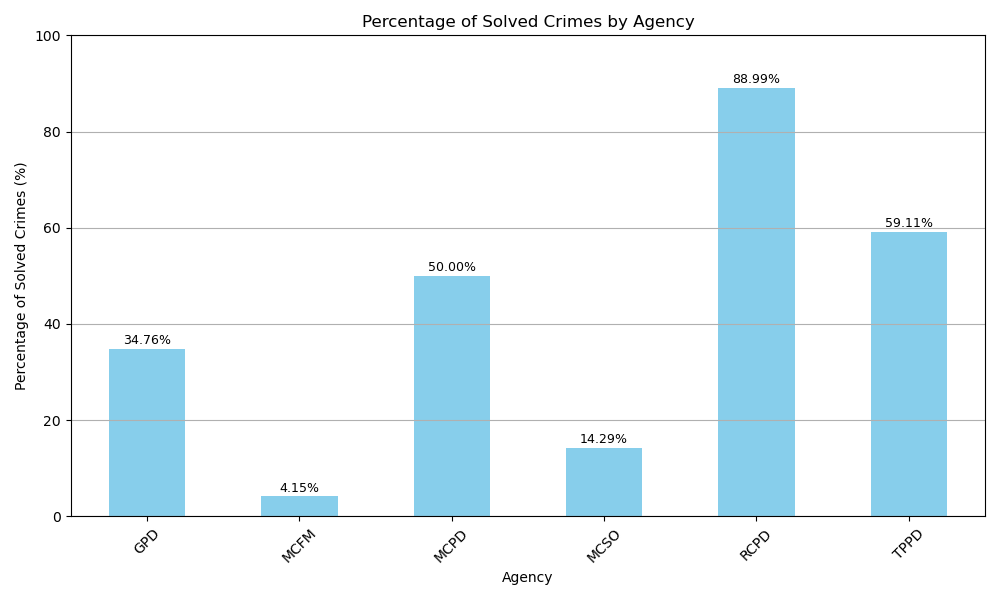

In [52]:
# Filtering out unsolved crimes, null values and bad entries
montgomery_crime_df['Solved'] = ~(montgomery_crime_df['End_Date_Time'].isnull() | (montgomery_crime_df['End_Date_Time'] == 0))

# calculating solved percentage and grouping it by Agency
solved_percentage = montgomery_crime_df.groupby('Agency')['Solved'].mean() * 100

# Making a bar plot
plt.figure(figsize=(10, 6))
bars = solved_percentage.plot(kind='bar', color='skyblue')
plt.title('Percentage of Solved Crimes by Agency')
plt.xlabel('Agency')
plt.ylabel('Percentage of Solved Crimes (%)')
plt.xticks(rotation=45)
plt.ylim(0, 100)  # Set y-axis limit from 0 to 100 for percentage
plt.grid(axis='y')

# Adding percentage values over bars
for index, value in enumerate(solved_percentage):
    plt.text(index, value + 1, f'{value:.2f}%', ha='center', color='black', fontsize=9)
plt.tight_layout()
plt.show()

## Machine Learning & Statistics
<a name='A6'></a>
We decided to predict, using machine learning algorithms, what type of crime can happen on the basis of Zip Code, Time_Category & Month Name. We explored few algorithms and then decided to implement Random Forest.

### What is Random Forest?
The Random Forest algorithm is a supervised machine learning algorithm that combines the predictions of multiple decision trees to produce a final prediction. It is an ensemble method, meaning it combines multiple base-level models (in this case, decision trees) to get improved results.
### How does it work?
The Random Forest algorithm works by creating a large number of decision trees and then combining their predictions. Each decision tree in the forest is trained on a different subset of the data. The algorithm randomly selects features and samples with replacement from the features chosen (bootstrap sample) to train each tree. After the data is split into subsets, decision trees are trained on these subsets. The process of training is the same as it would be for training an individual tree – we just make a lot more of them. Each individual tree contains one result that depends on the tree’s initial data. To get rid of the dependence on the initial data and produce a more accurate estimation, their output is combined into one result.

### Why is Random Forest a good choice for predicting the type of crime?
- Robustness against overfitting: If one tree makes an inaccurate prediction due to an outlier in its training set, another will most likely compensate for that prediction with the opposite outlier. Thus, a set of uncorrelated trees performs better than any of the individual ones taken separately.
- Handling of missing values: Random Forest can handle missing values in features without introducing bias into predictions.
- Easy to interpret: Every tree in the forest makes predictions independently, so you can look at any individual tree to understand its prediction.
- Applicable for both classification and regression: Random Forest has proven equally accurate results for both types of tasks.
- Cost-effective: Random Forest is much cheaper and faster to train when compared to other machine learning models.
- High coverage rates and low bias: The above makes the Random Forest classifier ideal for situations where there may be some missing values in your dataset or if you want to understand how much variance there is between different types of data output.

In [53]:
# subset the main dataset and save into new dataframe
crime_data = montgomery_crime_df[['Start_Date_Time', 'Crime Name1', 'Crime Name2',  'Zip Code', 'City', 'Year', 'Month_Name', 'Hour', 'Victims']]
crime_data.head()

,Start_Date_Time,Crime Name1,Crime Name2,Zip Code,City,Year,Month_Name,Hour,Victims
Incident ID,,,,,,,,,
201452140,2023-11-08 03:20:00,Crime Against Property,Robbery,20910.0,SILVER SPRING,2023,November,3,1
201452138,2023-11-08 02:30:00,Crime Against Property,Burglary/Breaking and Entering,20852.0,ROCKVILLE,2023,November,2,1
201452119,2023-11-07 21:15:00,Crime Against Property,False Pretenses/Swindle/Confidence Game,20906.0,SILVER SPRING,2023,November,21,1
201452132,2023-11-07 21:06:00,Crime Against Person,Aggravated Assault,20878.0,GAITHERSBURG,2023,November,21,5
201452133,2023-11-07 20:54:00,Crime Against Society,Disorderly Conduct,20877.0,GAITHERSBURG,2023,November,20,1


In [54]:
# Define bins and labels for time categories
bins = [-1, 5, 11, 17, 23]
labels = ['After Midnight', 'Morning', 'Afternoon', 'Evening']

# Assuming 'crime_data' is your DataFrame

# Create the 'Time_Category' column based on the 'Hour' column
# Using pd.cut to categorize the 'Hour' values into time bins
# right=False ensures that the intervals are left-closed (e.g., [0, 5), [5, 11), ...)
cut_by_hour = pd.cut(crime_data.loc[:,'Hour'], bins=bins, labels=labels, right=False)
crime_data.loc[:,'Time_Category'] = cut_by_hour

In [55]:
# Display first 5 records
crime_data.head()

,Start_Date_Time,Crime Name1,Crime Name2,Zip Code,City,Year,Month_Name,Hour,Victims,Time_Category
Incident ID,,,,,,,,,,
201452140,2023-11-08 03:20:00,Crime Against Property,Robbery,20910.0,SILVER SPRING,2023,November,3,1,After Midnight
201452138,2023-11-08 02:30:00,Crime Against Property,Burglary/Breaking and Entering,20852.0,ROCKVILLE,2023,November,2,1,After Midnight
201452119,2023-11-07 21:15:00,Crime Against Property,False Pretenses/Swindle/Confidence Game,20906.0,SILVER SPRING,2023,November,21,1,Evening
201452132,2023-11-07 21:06:00,Crime Against Person,Aggravated Assault,20878.0,GAITHERSBURG,2023,November,21,5,Evening
201452133,2023-11-07 20:54:00,Crime Against Society,Disorderly Conduct,20877.0,GAITHERSBURG,2023,November,20,1,Evening


In [56]:
# Selecting relevant columns
data = crime_data[['Zip Code', 'Time_Category', 'Month_Name']]
target = crime_data['Crime Name1']

# Convert categorical variables to numerical using one-hot encoding
data_encoded = pd.get_dummies(data, columns=['Zip Code', 'Time_Category', 'Month_Name'], drop_first=True)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data_encoded, target, test_size=0.2, random_state=42)

# Create a Random Forest Classifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model
clf.fit(X_train, y_train)

# Make predictions on the test set
predictions = clf.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, predictions)
print(f'Accuracy: {accuracy:.2f}')


Accuracy: 0.68


The model accuracy is 0.68, indicating that it correctly predicted the crime category approximately 68% of the time. However, there is room for improvement. Future Improvements:

- **Hyperparameter Tuning:**
  - The Random Forest model may benefit from fine-tuning of hyperparameters to enhance its predictive performance.

- **Imbalanced Data:**
  - If certain crime categories have significantly fewer instances, the model may be biased toward the majority class. For example: The 'Crime_Against_Property' category has 67% records in the dataset.

In [57]:
# Create a DataFrame with input data
input_data = pd.DataFrame({
   'Zip Code': ['20902'],
   'time_category': ['After Midnight'],
   'Month_Name': ['April']
})

# One-hot encode the input data to prepare it for the model
input_data_encoded = pd.get_dummies(input_data, columns=['Zip Code', 'time_category', 'Month_Name'], drop_first=True)

# Identify missing columns by finding the set difference
missing_columns = set(X_train.columns) - set(input_data_encoded.columns)

# Create a dictionary to hold the new columns with default value 0
new_columns = {}

# Add missing columns to the dictionary
for column in missing_columns:
    new_columns[column] = 0

# Create a new DataFrame from the dictionary
new_df = pd.DataFrame(new_columns, index=[0])

# Concatenate the new DataFrame with the existing encoded input data
input_data_encoded = pd.concat([input_data_encoded, new_df], axis=1)

# Reorder columns to match the training data
input_data_encoded = input_data_encoded[X_train.columns]

# Make a prediction using the trained classifier (clf)
prediction = clf.predict(input_data_encoded)

# Print the predicted crime category
print(f'Predicted Crime Category: {prediction[0]}')


Predicted Crime Category: Crime Against Property


## Correlation Matrix

In [58]:
# Create a copy of the original DataFrame for correlation analysis
corr = crime_data

In [59]:
# One-hot encode 'Crime Name1' and 'Time_Category' columns
dummies = pd.get_dummies(corr[['Crime Name1', 'Time_Category']],columns=['Crime Name1', 'Time_Category'], dtype='int')

In [60]:
# Include 'Victims' and 'Year' columns from the original DataFrame in the one-hot encoded DataFrame
dummies[['Victims','Year']] = corr[['Victims', 'Year']]

In [61]:
# Group the data by 'Year' and sum the one-hot encoded columns for each group
grouped_data = dummies.groupby('Year').sum()

# Calculate the total number of crimes ('Crime_Sum') for each year
grouped_data['Crime_Sum'] = dummies.groupby('Year').size()

In [62]:
# Display the result DataFrame
grouped_data

,Crime Name1_Crime Against Person,Crime Name1_Crime Against Property,Crime Name1_Crime Against Society,Time_Category_After Midnight,Time_Category_Morning,Time_Category_Afternoon,Time_Category_Evening,Victims,Crime_Sum
Year,,,,,,,,,
2017,2876,14921,5862,3597,2834,6940,9026,24242,23659
2018,3917,17447,8008,4426,3503,9090,10787,30209,29372
2019,3873,18363,6870,4298,3541,9045,10853,29911,29106
2020,3580,18566,3650,3688,3186,8347,9508,26612,25796
2021,4128,18398,2664,3933,3374,8193,8736,26074,25190
2022,4424,20033,3303,4388,3793,9021,9605,28807,27760
2023,3709,17837,2580,3245,3406,7976,8632,24991,24126


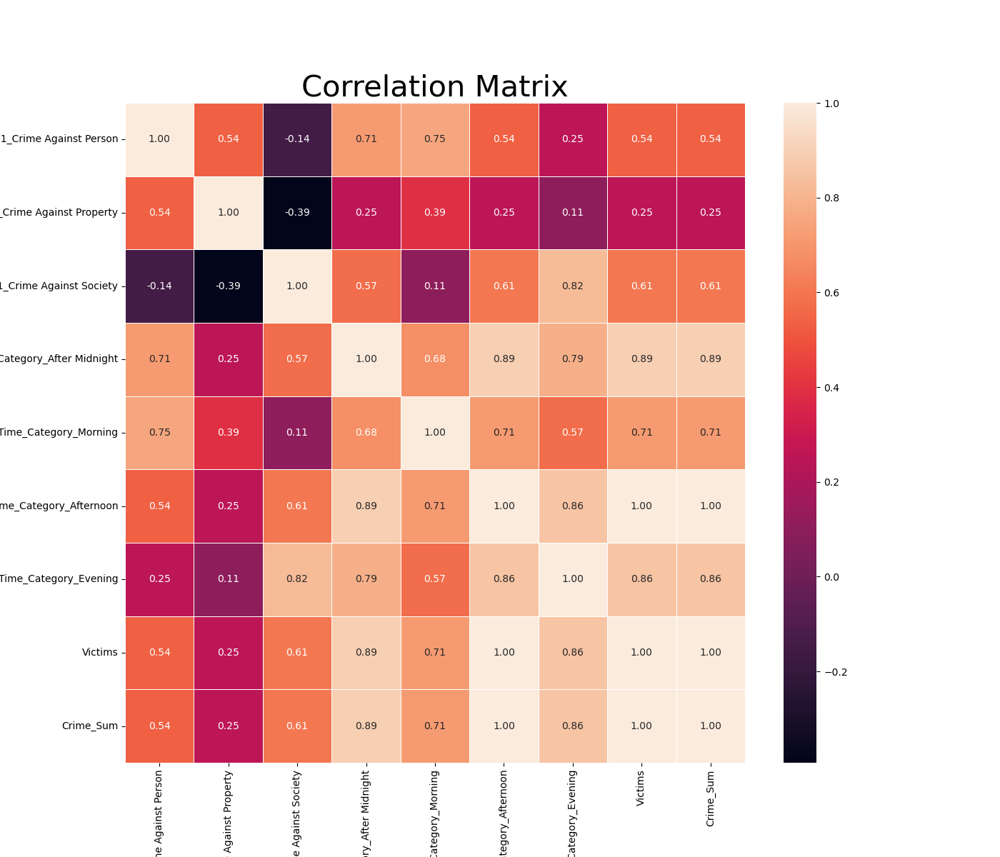

In [63]:
from scipy.stats import spearmanr

# Calculate the Spearman correlation matrix for the grouped data
corr = spearmanr(grouped_data).correlation

# Set up the size of the heatmap figure
plt.figure(figsize=(14, 12))

# Create a heatmap of the Spearman correlation matrix
ax = sns.heatmap(corr,
                 annot=True,          # Display correlation values in each cell
                 fmt='.2f',           # Format for the displayed values
                 linewidths=.5,       # Width of the lines separating cells
                 xticklabels=grouped_data.columns,  # Set x-axis labels based on DataFrame columns
                 yticklabels=grouped_data.columns)  # Set y-axis labels based on DataFrame columns
# Rotate x-axis labels for better readability
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
# Set the title of the heatmap
plt.title('Correlation Matrix', fontsize = 30)
plt.show()

- The correlation between 'Crime Sum' and 'Afternoon' is 0.96. This is a very high correlation, indicating a strong positive relationship. The afternoon might be a time when people are more likely to be out and about, which could increase the opportunities for crimes.

- The correlation between 'Crime Against Person' and 'After Midnight' is 0.86, and between 'Crime Against Person' and 'Morning' is 0.93. These correlations suggest a strong positive relationship between the time of the crime and the type of crime.
    - Similarly, the correlation of 0.86 between 'Crime Against Person' and 'After Midnight' suggests that crimes against persons are also more likely to occur after midnight. This could be due to the fact that people are less likely to be out and about after midnight, which could reduce the opportunities for crimes against persons.

- The correlation between 'Victims' and 'Afternoon' is 0.89. This indicates a strong positive relationship, suggesting that the number of victims tends to be higher during the afternoon. This could be due to various reasons:
    - Increased Human Activity: The afternoon is often a time when people are more active. This could increase the opportunities for crimes, leading to more victims.
    - Specific Crime Patterns: Some types of crimes might be more likely to occur during the afternoon.
    - Reporting Time: Victims might be more likely to report crimes that occur during the afternoon. This could be due to various reasons, such as the fact that people are more awake and alert during this time, or the fact that the afternoon is a common reporting time for crimes.

# Conclusion

From 2017 to 2020, crime rates in Montgomery County were very unpredictable - they would ebb and flow, and did not seem to correlated with any specific month. Crime against property wass the most common crime committed, followed by crime against society and crime against persons. However, Covid had a profound effect on crime in Montgomery County, specifically in regards to Crimes against Society. Further research is necessary to determine the specific cause for this drop. Crimes Against Persons and Property continue to rise, and in total crime rates are close to pre-pandemic levels.

When it comes to the Montgomery County Police Department, the physical location of a station and the policeforce has little impact on the density of surrounding crime. Crime rates are instead closely tied to the population of nearby cities, and police station locations are most likely chosen in correlation with population density as well. The specific police agency that has the highest solve-rate is Rockville City Police Department.

When evaluating cities to live in within Montgomery County based on safety, Silver Spring and Wheaton are the 2 with the most dense and frequent crimes. It is interesting to note that these cities are close to the District of Columbia - it would be reasonable to infer that crime is spilling over from the more populous U.S. capitol. The further you move from the major cities, the safer it gets - but the safest cities seem to be North Potomac and Rockville. 

Based on all of our analyses, Rockville is the safest city to live in within Montgomery County, both due to crime rates as well as the solve rate of the local police department. Regardless, anyone who is evaluating living in Montgomery County should stay inside after midnight, due to the high correlation between Crimes Against Person and crimes committed after midnight. If people are business owners, they should add enhanced security measures at their properties in the afternoon, when crimes against property are most likely to be committed. 


<a name='C'></a>

# References
<a name='References'></a>

Councilmanic. Montgomery County GIS Open Data 2.0, MD. (n.d.). https://opendata-mcgov-gis.hub.arcgis.com/datasets/mcgov-gis::councilmanic/explore?location=39.142744%2C-77.208800%2C10.87

Wikimedia Foundation. (2023, November 25). Montgomery County, Maryland. Wikipedia. https://en.wikipedia.org/wiki/Montgomery_County,_Maryland

Crimes against persons, property, and Society - Federal Bureau of ... (n.d.). https://ucr.fbi.gov/nibrs/2018/resource-pages/crimes_against_persons_property_and_society-2018.pdf

About Us Page, Montgomery County Police Department , Montgomery County, MD. (n.d.). https://www.montgomerycountymd.gov/pol/about.html 

Montgomery Planning - development in Montgomery County, MD. (n.d.-b). https://montgomeryplanning.org/wp-content/uploads/2022/05/Montgomery-County-Council-District-Profiles-2022-1.pdf 

Maryland, C. (2021, May 6). Covid timeline. CNS Maryland. https://cnsmaryland.org/interactives/spring-2021/covid-timeline/index.html 

# Glossary
<a name='Glossary'></a>
__Sector/Beat__: a specific area or geographical territory to which a patrol officer is assigned (beat is a subdivision of sector).

__Crime Start Time__: when a crime is reported, either to or by police.

__Crime End Time__: when the case for a crime is closed by police.

__Dispatch Time__: when a police office/unit is sent to the scene of a crime.